# Analyzing Neighborhoods and Recommending an area to start a restaurant in Brooklyn, New York

## Introduction

Brooklyn is a borough of New York City, in the American state of New York. It is the most-populous county in the state, the second-most densely populated county in the United States, and New York City's most populous borough, with an estimated residents of over 2 million in 2020. Named after the Dutch village of Breukelen, it shares a land border with the borough of Queens, at the western end of Long Island. Brooklyn has several bridge and tunnel connections to the borough of Manhattan across the East River, and the Verrazzano-Narrows Bridge connects it with Staten Island. 

Although it is New York's most populated borough it has a land area of only 70.82 square miles(183 sqaure km) making it New York's fourth smallest county with respect to land area.Since the 2010s, Brooklyn has evolved into a thriving hub of entrepreneurship, high technology start-up firms, postmodern art and design. With such immense population density there are no shortage of restaurants in such a small piece of land, but not all the restaurants in brooklyn are sustainable because of the wide range of preferances of taste and 

## Data Collection

The Data Required for this project have been collected from three diffrent sources

### Neighborhood Data
The Neighborhood Data for Brooklyn was collected from a governmnet website(https://www1.nyc.gov/site/finance/taxes/property-rolling-sales-data.page) and the data was first entered into google sheets as the data was basically an excel sheet with approximately 16000 rows and then converted into csv file by saving it with '.csv' extension. The data was then converted into a dataframe using the pd.read_csv function.

### Location Data
The location data required for this project along with the coordinates was collected from the website ‘http://download.geonames.org/export/zip/’ which contains zip codes, name of the location corresponding to the zipcode and the coordinates associated with that zip code for america. This was then converted into a dataframe and then cleaned by keeping only the latitude, longitude and the zip code column, to match the coordinates to the particular zip code in the original dataframe.

### Venues Data
The venues data was gathered using foursquare api which retrieves all the nearby venues with respect to a query which contains the names of the neighborhood and its coordinates. There is an option to limit the number of responses and to get the most popular venues within a user defined radius.


### Importing required libraries 

In [3]:
import numpy as np # library to handle data in a vectorized manner
import json
import requests # library to handle requests
from pandas.io.json import json_normalize
import matplotlib.cm as cm
import matplotlib.colors as colors
from sklearn.cluster import KMeans 
!pip install geopy  
from geopy.geocoders import Nominatim
!pip install folium
import folium
import matplotlib.pyplot as plt
import requests
from pandas.io.json import json_normalize
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn import metrics

     |████████████████████████████████| 94 kB 4.7 MB/s  eta 0:00:01


### Neighborhood Dataset
Uploading the .csv file and using watson studio’s built in method to convert it into a dataframe.


In [4]:
# The code was removed by Watson Studio for sharing.

,Brooklyn Rolling Sales File. All Sales From December 2019 - November 2020,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,PTS Sales as of 12/08/2020,Unnamed: 20
0,"For sales prior to the Final, Neighborhood Nam...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Building Class Category is based on Building C...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Note: Condominium and cooperative sales are on...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
4,3,BATH BEACH,01 ONE FAMILY DWELLINGS,1,6359,70,NaN,S1,8684 15TH AVENUE,NaN,...,1,1,2,"1,933","4,080",1930,1,S1,"1,300,000",4/28/2020


### Data Wrangling
Examining the columns of the dataframe and remove all the irrelevant columns and rows and making it easier to understand.


In [5]:
df = df.drop([df.index[0], df.index[1], df.index[2]])


In [6]:
df = df.drop(['Unnamed: 9','Unnamed: 2','Unnamed: 4','Unnamed: 5','Unnamed: 7','Unnamed: 11','Unnamed: 6','Unnamed: 3','Unnamed: 14', 'Unnamed: 15',' PTS Sales as of 12/08/2020 ', 'Unnamed: 20','Unnamed: 12', 'Unnamed: 13','Unnamed: 18','Unnamed: 17','Unnamed: 16'], axis = 1)
df.columns

Index(['Brooklyn Rolling Sales File.  All Sales From  December 2019 - November 2020',
       'Unnamed: 1', 'Unnamed: 8', 'Unnamed: 10'],
      dtype='object')

In [7]:
df1 = df.rename(columns = {'Brooklyn Rolling Sales File.  All Sales From  December 2019 - November 2020':'BOROUGH','Unnamed: 1':'NEIGHBORHOOD','Unnamed: 8':'Address','Unnamed: 10':'ZIP CODE'})

In [8]:
df2 = df1.drop([df.index[0]])

In [9]:
df2.set_index('BOROUGH')

,NEIGHBORHOOD,Address,ZIP CODE
BOROUGH,,,
3,BATH BEACH,8684 15TH AVENUE,11228
3,BATH BEACH,14 BAY 10TH STREET,11228
3,BATH BEACH,30 BAY 10TH STREET,11228
3,BATH BEACH,8645 BAY 16TH STREET,11214
3,BATH BEACH,79 BAY 20TH STREET,11214
...,...,...,...
3,WYCKOFF HEIGHTS,376 WEIRFIELD STREET,11237
3,WYCKOFF HEIGHTS,376 WEIRFIELD STREET,11237
3,WYCKOFF HEIGHTS,378 WEIRFIELD STREET,11237


In [10]:
df3 = df2.reset_index(drop = True)
df3 = df3.rename(columns={'ZIP CODE':'Zip'})
df3.shape

(18386, 4)

In [11]:
df3[["Zip"]] = df3[["Zip"]].apply(pd.to_numeric)

In [12]:

df3.dtypes

BOROUGH          object
NEIGHBORHOOD     object
Address          object
Zip             float64
dtype: object

### Location and Coordinates Dataset
Uploading the .csv file and using watson studio’s built in method to convert it into a dataframe and removing columns that are irrelevant 


In [13]:

body = client_5aab8aa15c1a401a8019c514d17cc228.get_object(Bucket='courseracapstone-donotdelete-pr-p9fauxpixwtvvq',Key='Book1.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

lt_lg = pd.read_csv(body)
lt_lg.head()


,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8,Column9,Column10,Column11,Column12
0,US,99553,Akutan,Alaska,AK,Aleutians East,13.0,NaN,NaN,54.1430,-165.7854,1.0
1,US,99571,Cold Bay,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.1858,-162.7211,1.0
2,US,99583,False Pass,Alaska,AK,Aleutians East,13.0,NaN,NaN,54.8542,-163.4113,1.0
3,US,99612,King Cove,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.0628,-162.3056,1.0
4,US,99661,Sand Point,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.3192,-160.4914,1.0


Removing Irrelevant Columns and renaming the required columns to make it easier to understand.

In [14]:
lt_lg.columns

Index(['Column1', 'Column2', 'Column3', 'Column4', 'Column5', 'Column6',
       'Column7', 'Column8', 'Column9', 'Column10', 'Column11', 'Column12'],
      dtype='object')

In [15]:
lt_lg1 = lt_lg.drop(['Column1','Column9', 'Column3', 'Column4', 'Column5', 'Column6','Column7', 'Column8', 'Column12'], axis = 1)

In [16]:
lt_lgUS = lt_lg1.rename(columns = {'Column2':'Zip', 'Column10':'Latitude', 'Column11':'Longitude'})

In [18]:
lt_lgUS.dtypes

Zip            int64
Latitude     float64
Longitude    float64
dtype: object

### Merging the dataframes

Merging the two Datasets by matching the zip codes to get latitudes and longitudes of all the neighborhoods

In [19]:
Brook1 = pd.merge(df3, lt_lgUS, on = 'Zip')

In [20]:
Brook1.head(10)

,BOROUGH,NEIGHBORHOOD,Address,Zip,Latitude,Longitude
0,3,BATH BEACH,8684 15TH AVENUE,11228.0,40.6174,-74.0121
1,3,BATH BEACH,14 BAY 10TH STREET,11228.0,40.6174,-74.0121
2,3,BATH BEACH,30 BAY 10TH STREET,11228.0,40.6174,-74.0121
3,3,BATH BEACH,140 BAY 8 STREET,11228.0,40.6174,-74.0121
4,3,BATH BEACH,145 BAY 7TH STREET,11228.0,40.6174,-74.0121
5,3,BATH BEACH,195 BAY 8TH ST,11228.0,40.6174,-74.0121
6,3,BATH BEACH,1586 INDEPENDENCE AVENUE,11228.0,40.6174,-74.0121
7,3,BATH BEACH,8645 14TH AVENUE,11228.0,40.6174,-74.0121
8,3,BATH BEACH,40 BAY 7TH STREET,11228.0,40.6174,-74.0121
9,3,BATH BEACH,61 BAY 8TH STREET,11228.0,40.6174,-74.0121


## Data Wrangling

Checking the combined dataframe for any missing values and either replacing the missing values with the mean or dropping the rows entirely

In [21]:
missing_data = Brook1.isnull()
missing_data.head()

,BOROUGH,NEIGHBORHOOD,Address,Zip,Latitude,Longitude
0,False,False,False,False,False,False
1,False,False,False,False,False,False
2,False,False,False,False,False,False
3,False,False,False,False,False,False
4,False,False,False,False,False,False


In [22]:
for column in missing_data.columns.values.tolist():
    print(column)
    print (missing_data[column].value_counts())
    print("")    

BOROUGH
False    18385
Name: BOROUGH, dtype: int64

NEIGHBORHOOD
False    18385
Name: NEIGHBORHOOD, dtype: int64

Address
False    18385
Name: Address, dtype: int64

Zip
False    18385
Name: Zip, dtype: int64

Latitude
False    18385
Name: Latitude, dtype: int64

Longitude
False    18385
Name: Longitude, dtype: int64



In [23]:
Brook1.shape

(18385, 6)

In [26]:
address = 'Brooklyn, NY'
geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of Brooklyn are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Brooklyn are 40.6501038, -73.9495823.


### Visualisation of the data
Visualising the various neighborhoods in brooklyn using folium library

In [27]:
map_brook = folium.Map(location = [latitude, longitude], zoom_start = 10 )
for lat, lng, label in zip(Brook1['Latitude'], Brook1['Longitude'], Brook1['NEIGHBORHOOD']):
    label = folium.Popup(label, parse_html = True)
    folium.CircleMarker(
    [lat,lng],
    radius = 4,
    popup = label,
    colour = 'blue',
    fill = True,
    fill_colour = '#3186cc',
    fill_opacity = 0.7,
    parse_html = False).add_to(map_brook)
    
map_brook

### Foursquare API

Initialising the Foursquare api by Client ID and Client Secret and retrieveing data for all the values in the dataframe by defining a function.

In [1]:
# The code was removed by Watson Studio for sharing.

Your credentails:
CLIENT_ID: ACDIIZMI0NLKINMRCBYE43JF2N0TESZGMEPWLVKX4ZO04KKG
CLIENT_SECRET:LFUXHSL4X0TYJTWTV5T5FARISWW4AANUHDJRDNZ1WNDJ1GQU


Next we define a method called GetNearbyVenues that retrieves all the venues within a 3 kilometer radius of a particular neighborhood.

In [38]:
def getNearbyVenues(names, latitude, longitude, radius=3000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitude, longitude):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

We now retrieve the unique neighborhoods in the data set

In [39]:

Neighborhood =  Brook1.NEIGHBORHOOD.unique()
Neighborhood

array(['BATH BEACH', 'BAY RIDGE', 'BENSONHURST', 'DYKER HEIGHTS',
       'GRAVESEND', 'BOROUGH PARK', 'BUSH TERMINAL', 'SUNSET PARK',
       'BEDFORD STUYVESANT', 'BUSHWICK', 'FLATBUSH-LEFFERTS GARDEN',
       'OCEAN HILL', 'WILLIAMSBURG-EAST', 'CROWN HEIGHTS',
       'FLATBUSH-NORTH', 'CLINTON HILL', 'FORT GREENE', 'NAVY YARD',
       'WILLIAMSBURG-CENTRAL', 'PROSPECT HEIGHTS', 'BERGEN BEACH',
       'FLATBUSH-EAST', 'FLATLANDS', 'MARINE PARK', 'MILL BASIN',
       'OLD MILL BASIN', 'BOERUM HILL', 'DOWNTOWN-FULTON MALL', 'GOWANUS',
       'PARK SLOPE', 'BROOKLYN HEIGHTS', 'CARROLL GARDENS', 'COBBLE HILL',
       'COBBLE HILL-WEST', 'DOWNTOWN-FULTON FERRY', 'DOWNTOWN-METROTECH',
       'FLATBUSH-CENTRAL', 'KENSINGTON', 'OCEAN PARKWAY-NORTH',
       'WINDSOR TERRACE', 'MIDWOOD', 'WILLIAMSBURG-NORTH',
       'WILLIAMSBURG-SOUTH', 'BRIGHTON BEACH', 'MANHATTAN BEACH',
       'OCEAN PARKWAY-SOUTH', 'SHEEPSHEAD BAY', 'MADISON', 'BROWNSVILLE',
       'WYCKOFF HEIGHTS', 'CYPRESS HILLS', 'EAST 

Make a new dataframe with all the neighborhoods and their respective co-ordinates.

In [40]:
Brook_Neighborhoods = pd.DataFrame(Neighborhood, columns = ["Neighborhoods"])
Brook_Neighborhoods.head()


,Neighborhoods
0,BATH BEACH
1,BAY RIDGE
2,BENSONHURST
3,DYKER HEIGHTS
4,GRAVESEND


In [41]:
Brook_Neighborhood2 = Brook_Neighborhoods.assign(Latitude = ['40.60','40.62','40.61','40.62',
                                                             '40.59','40.63','40.65','40.65',
                                                             '40.68','40.69','40.65',
                                                             '40.67','40.66','40.64','40.68',
                                                             '40.69','40.69','40.70',
                                                             '40.71','40.67','40.62',
                                                             '40.64','40.62','40.61','40.60',
                                                             '40.61','40.68','40.69','40.67',
                                                             '40.67','40.69','40.67','40.68',
                                                             '40.68','40.70','40.69',
                                                             '40.64','40.63','40.38',
                                                             '40.65','40.65','40.62',
                                                             '40.72','40.70','40.57',
                                                             '40.57','40.59','40.60','40.66',
                                                             '40.70','40.68','40.65','40.64',
                                                             '40.65','40.67','40.57','40.57',
                                                             '40.58','40.67','40.73'])

In [42]:
Brook_Neighborhood2.head()


,Neighborhoods,Latitude
0,BATH BEACH,40.60
1,BAY RIDGE,40.62
2,BENSONHURST,40.61
3,DYKER HEIGHTS,40.62
4,GRAVESEND,40.59


In [43]:
Brooklyn = Brook_Neighborhood2.assign(Longitude=['-74.00','-74.02','-73.99','-74.00',
                                                 '-73.97','-73.99','-74.00','-74.00',
                                                 '-73.94','-73.91','-73.95',
                                                 '-73.91','-73.94','-73.96','-73.96',
                                                 '-73.97','-73.97','-73.95',
                                                 '-73.93','-73.96','-73.90',
                                                 '-73.93','-73.93','-73.93','-73.91',
                                                 '-73.91','-73.98','-73.98','-73.98',
                                                 '-73.98','-73.99','-73.99','-73.99',
                                                 '-73.99','-73.99','-73.98',
                                                 '-73.92','-73.97','-73.58',
                                                 '-73.97','-73.96','-73.96',
                                                 '-73.97','-73.95','-73.93',
                                                 '-73.96','-73.94','-73.94','-73.91',
                                                 '-73.91','-73.87','-73.87','-73.90',
                                                 '-73.87','-74.00','-73.97','-74.00',
                                                 '-73.92','-73.98','-73.95'])

In [44]:
Brooklyn.head()

,Neighborhoods,Latitude,Longitude
0,BATH BEACH,40.60,-74.00
1,BAY RIDGE,40.62,-74.02
2,BENSONHURST,40.61,-73.99
3,DYKER HEIGHTS,40.62,-74.00
4,GRAVESEND,40.59,-73.97


Using the getNearbyVenues function on the new Neighborhood Dataset

In [45]:
Brook_Venues1= getNearbyVenues(names = Brooklyn['Neighborhoods'], latitude = Brooklyn['Latitude'], longitude = Brooklyn['Longitude'], radius=3000)

BATH BEACH
BAY RIDGE
BENSONHURST
DYKER HEIGHTS
GRAVESEND
BOROUGH PARK
BUSH TERMINAL
SUNSET PARK
BEDFORD STUYVESANT
BUSHWICK
FLATBUSH-LEFFERTS GARDEN
OCEAN HILL
WILLIAMSBURG-EAST
CROWN HEIGHTS
FLATBUSH-NORTH
CLINTON HILL
FORT GREENE
NAVY YARD
WILLIAMSBURG-CENTRAL
PROSPECT HEIGHTS
BERGEN BEACH
FLATBUSH-EAST
FLATLANDS
MARINE PARK
MILL BASIN
OLD MILL BASIN
BOERUM HILL
DOWNTOWN-FULTON MALL
GOWANUS
PARK SLOPE
BROOKLYN HEIGHTS
CARROLL GARDENS
COBBLE HILL
COBBLE HILL-WEST
DOWNTOWN-FULTON FERRY
DOWNTOWN-METROTECH
FLATBUSH-CENTRAL
KENSINGTON
OCEAN PARKWAY-NORTH
WINDSOR TERRACE
MIDWOOD
WILLIAMSBURG-NORTH
WILLIAMSBURG-SOUTH
BRIGHTON BEACH
MANHATTAN BEACH
OCEAN PARKWAY-SOUTH
SHEEPSHEAD BAY
MADISON
BROWNSVILLE
WYCKOFF HEIGHTS
CYPRESS HILLS
EAST NEW YORK
CANARSIE
SPRING CREEK
RED HOOK
CONEY ISLAND
SEAGATE
GERRITSEN BEACH
PARK SLOPE SOUTH
GREENPOINT


In [46]:
Brooklyn_Venues=Brook_Venues1


Lets take a look at our venues Dataframe.


In [47]:
Brooklyn_Venues.head(10)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,BATH BEACH,40.60,-74.00,Bay Parkway Water Front,40.595941,-74.000917,Surf Spot
1,BATH BEACH,40.60,-74.00,Five Guys,40.595236,-74.000225,Burger Joint
2,BATH BEACH,40.60,-74.00,Caesar's Bay Shopping Center,40.594946,-73.999706,Shopping Plaza
3,BATH BEACH,40.60,-74.00,Bensonhurst Park,40.597065,-73.998340,Park
4,BATH BEACH,40.60,-74.00,King's Kitchen,40.603844,-73.996960,Cantonese Restaurant
5,BATH BEACH,40.60,-74.00,Panino Rustico,40.610410,-74.003103,Italian Restaurant
6,BATH BEACH,40.60,-74.00,Jmart 新世界超市,40.610080,-74.001221,Supermarket
7,BATH BEACH,40.60,-74.00,Ichi Sushi,40.601774,-73.993869,Sushi Restaurant
8,BATH BEACH,40.60,-74.00,La Casa Bella,40.590570,-73.991666,Italian Restaurant
9,BATH BEACH,40.60,-74.00,The Original John's Deli,40.597055,-73.985378,Sandwich Place


In [49]:
Brooklyn_Venues.shape

(5886, 7)

In [50]:
print("There are {} unique categories of venues".format(len(Brooklyn_Venues['Venue Category'].unique())))

There are 268 unique categories of venues


### Examining each Neighborhood
 We noe examine each neighborhood by one hot encoding the dataframe returned from the getNearbyVeneus function.

In [54]:
Brooklyn_onehot = pd.get_dummies(Brooklyn_Venues[['Venue Category']], prefix = "", prefix_sep = "")

Brooklyn_onehot['Neighborhood'] = Brooklyn_Venues['Neighborhood']

fixed_columns = [Brooklyn_onehot.columns[-1]]+list(Brooklyn_onehot.columns[:-1])
Brooklyn_onehot = Brooklyn_onehot[fixed_columns]

Brooklyn_onehot.head(100)

,Zoo,African Restaurant,American Restaurant,Animal Shelter,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,...,Video Game Store,Vietnamese Restaurant,Warehouse Store,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yemeni Restaurant,Yoga Studio
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
97,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
98,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [55]:
Brooklyn_onehot.shape

(5886, 268)

Adding the Neighborhood column to the one hot encoded dataframe

In [56]:
Brooklyn_Grouped = Brooklyn_onehot.groupby('Neighborhood').mean().reset_index()
Brooklyn_Grouped.head()

,Neighborhood,Zoo,African Restaurant,American Restaurant,Animal Shelter,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Video Game Store,Vietnamese Restaurant,Warehouse Store,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yemeni Restaurant,Yoga Studio
0,BATH BEACH,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00,0.01,0.01,0.0,0.00,0.00,0.0,0.0,0.00,0.00
1,BAY RIDGE,0.0,0.00,0.02,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00,0.00,0.00,0.0,0.01,0.00,0.0,0.0,0.01,0.01
2,BEDFORD STUYVESANT,0.0,0.02,0.02,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00,0.00,0.00,0.0,0.01,0.03,0.0,0.0,0.00,0.02
3,BENSONHURST,0.0,0.00,0.01,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00,0.02,0.01,0.0,0.00,0.00,0.0,0.0,0.00,0.00
4,BERGEN BEACH,0.0,0.00,0.02,0.0,0.0,0.0,0.0,0.0,0.0,...,0.01,0.00,0.00,0.0,0.00,0.00,0.0,0.0,0.00,0.00


In [57]:
Brooklyn_Grouped.shape

(59, 268)

Defining a function to return the most common venues for all the neighborhood in the dataframe.

In [58]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

Retrieving top 5 venues with their frequency of occurence within the specified radius to understand the data further.

In [59]:
num_top_venues = 5

for hood in Brooklyn_Grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = Brooklyn_Grouped[Brooklyn_Grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    

----BATH BEACH----
                venue  freq
0         Pizza Place  0.09
1              Bakery  0.09
2  Italian Restaurant  0.07
3                Park  0.05
4               Beach  0.04
----BAY RIDGE----
                  venue  freq
0           Pizza Place  0.09
1    Italian Restaurant  0.06
2                Bakery  0.05
3  Gym / Fitness Center  0.04
4                   Bar  0.04
----BEDFORD STUYVESANT----
                  venue  freq
0                   Bar  0.11
1           Coffee Shop  0.08
2          Cocktail Bar  0.05
3           Pizza Place  0.05
4  Caribbean Restaurant  0.04
----BENSONHURST----
                venue  freq
0         Pizza Place  0.11
1  Italian Restaurant  0.08
2              Bakery  0.08
3          Bagel Shop  0.04
4       Grocery Store  0.03
----BERGEN BEACH----
                  venue  freq
0           Pizza Place  0.12
1              Pharmacy  0.09
2  Caribbean Restaurant  0.08
3            Donut Shop  0.05
4        Discount Store  0.04
----BOERUM HILL----

Making a new dataframe with Top 10 common venues for a neighborhood.

In [60]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = Brooklyn_Grouped['Neighborhood']

for ind in np.arange(Brooklyn_Grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(Brooklyn_Grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head(10)


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BATH BEACH,Pizza Place,Bakery,Italian Restaurant,Park,Bagel Shop,Beach,Coffee Shop,Grocery Store,Discount Store,Department Store
1,BAY RIDGE,Pizza Place,Italian Restaurant,Bakery,Gym / Fitness Center,Spa,Bar,Coffee Shop,Grocery Store,Greek Restaurant,Bagel Shop
2,BEDFORD STUYVESANT,Bar,Coffee Shop,Cocktail Bar,Pizza Place,Caribbean Restaurant,New American Restaurant,Wine Shop,Italian Restaurant,Bakery,Mexican Restaurant
3,BENSONHURST,Pizza Place,Italian Restaurant,Bakery,Bagel Shop,Park,Sushi Restaurant,Grocery Store,Food & Drink Shop,Russian Restaurant,Supermarket
4,BERGEN BEACH,Pizza Place,Pharmacy,Caribbean Restaurant,Donut Shop,Discount Store,Ice Cream Shop,Park,Bagel Shop,Diner,Bank
5,BOERUM HILL,Cocktail Bar,Coffee Shop,Bar,Ice Cream Shop,Bookstore,Park,Bakery,Pizza Place,Italian Restaurant,Grocery Store
6,BOROUGH PARK,Café,Pizza Place,Bakery,Italian Restaurant,Coffee Shop,Mexican Restaurant,Vietnamese Restaurant,Bar,Park,Thai Restaurant
7,BRIGHTON BEACH,Pizza Place,Bar,Italian Restaurant,Coffee Shop,Bakery,Japanese Restaurant,Gourmet Shop,Wine Bar,New American Restaurant,Chinese Restaurant
8,BROOKLYN HEIGHTS,Coffee Shop,Pizza Place,Italian Restaurant,Ice Cream Shop,Cocktail Bar,American Restaurant,Bakery,Bookstore,Gym,Gym / Fitness Center
9,BROWNSVILLE,Caribbean Restaurant,Pizza Place,Bakery,Pharmacy,Park,Gym / Fitness Center,Gym,Deli / Bodega,Indian Restaurant,Café


In [61]:
print('',neighborhoods_venues_sorted.shape)

 (59, 11)


In [62]:
df1 = Brooklyn_Grouped.drop('Neighborhood', axis = 1)

### Clustering Neighborhoods

After grouping the venues by their occurence we now group the neighborhood using KMeans clustering, but to determine the number of clusters we use the elbow method to find optimum clusters.

In [63]:
distortions = []

K = range(1,20)
for k in K:
    kmean = KMeans(n_clusters=k, random_state=0, n_init = 50, max_iter = 500)
    kmean.fit(df1)
    distortions.append(kmean.inertia_)

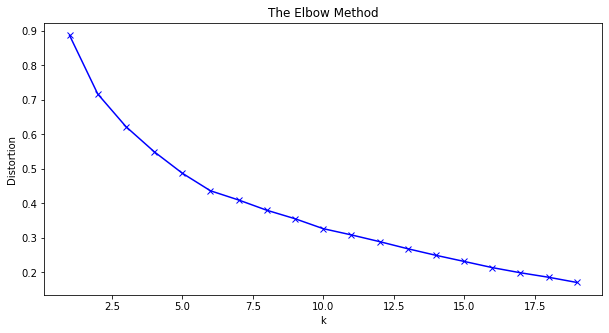

In [64]:
plt.figure(figsize=(10,5))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method')
plt.show()

We can see that there is a considerable change in Distortion at the K value 6 hence we choose 6 as the number of clusters.

In [65]:
K = 6
Brook_Clustering = KMeans(n_clusters = K, init = "k-means++", random_state = 13).fit(df1)



Getting the cluster labels and assigning it to the respective neighborhoods in the dataframe.

In [66]:
Brook_Clustering.labels_

array([0, 0, 2, 0, 5, 3, 1, 2, 3, 5, 1, 2, 5, 3, 3, 3, 3, 4, 1, 0, 3, 3,
       3, 0, 0, 5, 5, 1, 3, 0, 3, 4, 3, 4, 3, 1, 0, 4, 0, 1, 0, 2, 5, 4,
       0, 3, 3, 3, 3, 4, 4, 0, 1, 2, 1, 0, 3, 1, 2], dtype=int32)

In [67]:
neighborhoods_venues_sorted.insert(0, 'Cluster_Labels', Brook_Clustering.labels_)

In [68]:
Brooklyn_Merged = Brooklyn
Brooklyn_Merged = Brooklyn_Merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhoods')
Brooklyn_Merged.shape

(60, 14)

Foursquare api fails to retrieve venues for the neighborhood OceanParkway-south, hence we drop the entire row corresponding to that neighborhood.

In [69]:
Brooklyn_Merged1 = Brooklyn_Merged.dropna()

Let's have a look at the dataframe with its respective clustering labels.

In [70]:
Brooklyn_Merged1.head()

,Neighborhoods,Latitude,Longitude,Cluster_Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BATH BEACH,40.60,-74.00,0.0,Pizza Place,Bakery,Italian Restaurant,Park,Bagel Shop,Beach,Coffee Shop,Grocery Store,Discount Store,Department Store
1,BAY RIDGE,40.62,-74.02,0.0,Pizza Place,Italian Restaurant,Bakery,Gym / Fitness Center,Spa,Bar,Coffee Shop,Grocery Store,Greek Restaurant,Bagel Shop
2,BENSONHURST,40.61,-73.99,0.0,Pizza Place,Italian Restaurant,Bakery,Bagel Shop,Park,Sushi Restaurant,Grocery Store,Food & Drink Shop,Russian Restaurant,Supermarket
3,DYKER HEIGHTS,40.62,-74.00,0.0,Pizza Place,Bakery,Italian Restaurant,Spa,Vietnamese Restaurant,Cosmetics Shop,Burger Joint,American Restaurant,Sandwich Place,Scenic Lookout
4,GRAVESEND,40.59,-73.97,4.0,Pizza Place,Italian Restaurant,Grocery Store,Restaurant,Bakery,Bagel Shop,Turkish Restaurant,Sushi Restaurant,Theme Park Ride / Attraction,Mexican Restaurant


Converting the columns required for mapping from object type to integer, floating point and string

In [71]:
Brooklyn_Merged1 = Brooklyn_Merged1.astype({"Cluster_Labels":'int', "Latitude":'float', "Longitude":'float', "Neighborhoods":'str'})


Visualising the clustering via folium with different color given to different cluster.

In [72]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

x = np.arange(K)
ys = [i + x + (i*x)**2 for i in range(K)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

markers_colors = []
for lat, lon, poi, cluster in zip(Brooklyn_Merged1['Latitude'], Brooklyn_Merged1['Longitude'],Brooklyn_Merged1['Neighborhoods'], Brooklyn_Merged1['Cluster_Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters



Analyzing each neighborhood to find the neighborhood most suitable to open a new restaurant.

## First Cluster

In [73]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 0, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BATH BEACH,40.60,Pizza Place,Bakery,Italian Restaurant,Park,Bagel Shop,Beach,Coffee Shop,Grocery Store,Discount Store,Department Store
1,BAY RIDGE,40.62,Pizza Place,Italian Restaurant,Bakery,Gym / Fitness Center,Spa,Bar,Coffee Shop,Grocery Store,Greek Restaurant,Bagel Shop
2,BENSONHURST,40.61,Pizza Place,Italian Restaurant,Bakery,Bagel Shop,Park,Sushi Restaurant,Grocery Store,Food & Drink Shop,Russian Restaurant,Supermarket
3,DYKER HEIGHTS,40.62,Pizza Place,Bakery,Italian Restaurant,Spa,Vietnamese Restaurant,Cosmetics Shop,Burger Joint,American Restaurant,Sandwich Place,Scenic Lookout
22,FLATLANDS,40.62,Pizza Place,Caribbean Restaurant,Pharmacy,Clothing Store,Italian Restaurant,Bakery,Coffee Shop,Bagel Shop,Deli / Bodega,Gym
23,MARINE PARK,40.61,Pizza Place,Pharmacy,Bagel Shop,Italian Restaurant,Sushi Restaurant,American Restaurant,Mexican Restaurant,Gym,Donut Shop,Japanese Restaurant
24,MILL BASIN,40.60,Pizza Place,Bagel Shop,Italian Restaurant,Deli / Bodega,Pharmacy,Discount Store,Convenience Store,Ice Cream Shop,Beach,Diner
25,OLD MILL BASIN,40.61,Pizza Place,Pharmacy,Bagel Shop,American Restaurant,Italian Restaurant,Diner,Donut Shop,Ice Cream Shop,Park,Caribbean Restaurant
41,WILLIAMSBURG-NORTH,40.62,Pizza Place,Italian Restaurant,Bakery,Caribbean Restaurant,Coffee Shop,Sushi Restaurant,Mexican Restaurant,Bubble Tea Shop,Bagel Shop,Burger Joint
47,MADISON,40.60,Pizza Place,Sushi Restaurant,Italian Restaurant,Bagel Shop,Turkish Restaurant,Sandwich Place,Donut Shop,Food & Drink Shop,Japanese Restaurant,Restaurant


## Second Cluster

In [72]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 1, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
5,BOROUGH PARK,40.63,Café,Pizza Place,Bakery,Italian Restaurant,Coffee Shop,Mexican Restaurant,Vietnamese Restaurant,Bar,Park,Thai Restaurant
6,BUSH TERMINAL,40.65,Café,Bar,American Restaurant,Pizza Place,Mexican Restaurant,Coffee Shop,Wine Shop,Italian Restaurant,Brewery,Vietnamese Restaurant
7,SUNSET PARK,40.65,Café,Bar,American Restaurant,Pizza Place,Mexican Restaurant,Coffee Shop,Wine Shop,Italian Restaurant,Brewery,Vietnamese Restaurant
10,FLATBUSH-LEFFERTS GARDEN,40.65,Caribbean Restaurant,Café,Pizza Place,Coffee Shop,Park,Bakery,Thai Restaurant,Cocktail Bar,Garden,Playground
12,WILLIAMSBURG-EAST,40.66,Caribbean Restaurant,Café,Cocktail Bar,Coffee Shop,Bakery,Pizza Place,Park,Garden,Bar,Bagel Shop
13,CROWN HEIGHTS,40.64,Café,Caribbean Restaurant,Coffee Shop,Pizza Place,Thai Restaurant,Park,Bakery,Grocery Store,Playground,Bar
37,KENSINGTON,40.63,Pizza Place,Caribbean Restaurant,Coffee Shop,Italian Restaurant,Wine Shop,Park,Bar,Grocery Store,Thai Restaurant,Mexican Restaurant
39,WINDSOR TERRACE,40.65,Café,Playground,Coffee Shop,Garden,Park,American Restaurant,Wine Shop,Caribbean Restaurant,Grocery Store,Italian Restaurant
40,MIDWOOD,40.65,Café,Coffee Shop,Caribbean Restaurant,Thai Restaurant,Park,Garden,Playground,Italian Restaurant,Pizza Place,Bar


## Third Cluster

In [73]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 2, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
8,BEDFORD STUYVESANT,40.68,Bar,Coffee Shop,Cocktail Bar,Pizza Place,Caribbean Restaurant,New American Restaurant,Wine Shop,Italian Restaurant,Bakery,Mexican Restaurant
9,BUSHWICK,40.69,Bar,Coffee Shop,Bakery,Mexican Restaurant,Pizza Place,Italian Restaurant,Park,Nightclub,Cocktail Bar,Gym
17,NAVY YARD,40.70,Pizza Place,Bar,Italian Restaurant,Coffee Shop,Bakery,Japanese Restaurant,Gourmet Shop,Wine Bar,New American Restaurant,Chinese Restaurant
18,WILLIAMSBURG-CENTRAL,40.71,Bar,Coffee Shop,Bakery,Pizza Place,Cocktail Bar,Italian Restaurant,Brewery,Mexican Restaurant,Music Venue,New American Restaurant
43,BRIGHTON BEACH,40.70,Pizza Place,Bar,Italian Restaurant,Coffee Shop,Bakery,Japanese Restaurant,Gourmet Shop,Wine Bar,New American Restaurant,Chinese Restaurant
49,WYCKOFF HEIGHTS,40.70,Bar,Coffee Shop,Mexican Restaurant,Bakery,Nightclub,Pizza Place,Italian Restaurant,Cocktail Bar,Café,Brewery


## Fourth Cluster

In [75]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 3, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
14,FLATBUSH-NORTH,40.68,Bar,Cocktail Bar,Italian Restaurant,Wine Shop,New American Restaurant,Coffee Shop,Pizza Place,Bakery,Tiki Bar,Café
15,CLINTON HILL,40.69,Bar,Coffee Shop,Italian Restaurant,Cocktail Bar,Pizza Place,American Restaurant,Wine Shop,Ice Cream Shop,Bakery,Bookstore
16,FORT GREENE,40.69,Bar,Coffee Shop,Italian Restaurant,Cocktail Bar,Pizza Place,American Restaurant,Wine Shop,Ice Cream Shop,Bakery,Bookstore
19,PROSPECT HEIGHTS,40.67,Cocktail Bar,Coffee Shop,Wine Shop,Caribbean Restaurant,Café,Bar,Park,New American Restaurant,Garden,Japanese Restaurant
26,BOERUM HILL,40.68,Cocktail Bar,Coffee Shop,Bar,Ice Cream Shop,Bookstore,Park,Bakery,Pizza Place,Italian Restaurant,Grocery Store
27,DOWNTOWN-FULTON MALL,40.69,Cocktail Bar,Italian Restaurant,American Restaurant,Pizza Place,Bakery,Bar,Coffee Shop,Bookstore,Ice Cream Shop,Yoga Studio
28,GOWANUS,40.67,Bar,Coffee Shop,Pizza Place,Park,Cocktail Bar,Brewery,Italian Restaurant,Ice Cream Shop,Bagel Shop,Mexican Restaurant
29,PARK SLOPE,40.67,Bar,Coffee Shop,Pizza Place,Park,Cocktail Bar,Brewery,Italian Restaurant,Ice Cream Shop,Bagel Shop,Mexican Restaurant
30,BROOKLYN HEIGHTS,40.69,Coffee Shop,Pizza Place,Italian Restaurant,Ice Cream Shop,Cocktail Bar,American Restaurant,Bakery,Bookstore,Gym,Gym / Fitness Center
31,CARROLL GARDENS,40.67,Coffee Shop,Pizza Place,Italian Restaurant,Bar,Ice Cream Shop,Brewery,Cocktail Bar,Park,Mexican Restaurant,Farmers Market


## Fifth Cluster

In [76]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 4, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,GRAVESEND,40.59,Pizza Place,Italian Restaurant,Grocery Store,Restaurant,Bakery,Bagel Shop,Turkish Restaurant,Sushi Restaurant,Theme Park Ride / Attraction,Mexican Restaurant
44,MANHATTAN BEACH,40.57,Beach,Bar,Grocery Store,Café,Seafood Restaurant,Pizza Place,Sandwich Place,Ice Cream Shop,Bagel Shop,Turkish Restaurant
45,OCEAN PARKWAY-SOUTH,40.57,Beach,Theme Park Ride / Attraction,Pizza Place,Grocery Store,Restaurant,Sushi Restaurant,Bar,Turkish Restaurant,Baseball Stadium,Coffee Shop
46,SHEEPSHEAD BAY,40.59,Sushi Restaurant,Turkish Restaurant,Pizza Place,Grocery Store,Russian Restaurant,Bagel Shop,Seafood Restaurant,Park,Sandwich Place,Japanese Restaurant
55,CONEY ISLAND,40.57,Beach,Pizza Place,Theme Park Ride / Attraction,Grocery Store,Restaurant,Turkish Restaurant,Bar,Caribbean Restaurant,Baseball Stadium,Bakery
56,SEAGATE,40.57,Theme Park Ride / Attraction,Theme Park,Beach,Pizza Place,Aquarium,Park,Mexican Restaurant,Baseball Stadium,Gift Shop,Coffee Shop
57,GERRITSEN BEACH,40.58,Bar,Pizza Place,Seafood Restaurant,Beach,Sandwich Place,Sushi Restaurant,Turkish Restaurant,Bagel Shop,Park,Donut Shop


## Sixth Cluster

In [77]:
Brooklyn_Merged1.loc[Brooklyn_Merged1['Cluster_Labels'] == 5, Brooklyn_Merged1.columns[[0] + [1] + list(range(4, Brooklyn_Merged1.shape[1]))]]

,Neighborhoods,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
11,OCEAN HILL,40.67,Caribbean Restaurant,Pizza Place,Bakery,Park,Coffee Shop,Café,Juice Bar,Museum,Bar,Gym
20,BERGEN BEACH,40.62,Pizza Place,Pharmacy,Caribbean Restaurant,Donut Shop,Discount Store,Ice Cream Shop,Park,Bagel Shop,Diner,Bank
21,FLATBUSH-EAST,40.64,Caribbean Restaurant,Pizza Place,Donut Shop,Chinese Restaurant,Juice Bar,Italian Restaurant,Deli / Bodega,Gym / Fitness Center,Café,Bakery
36,FLATBUSH-CENTRAL,40.64,Caribbean Restaurant,Pizza Place,Pharmacy,Deli / Bodega,Coffee Shop,Convenience Store,Chinese Restaurant,Ice Cream Shop,Gym / Fitness Center,Donut Shop
48,BROWNSVILLE,40.66,Caribbean Restaurant,Pizza Place,Bakery,Pharmacy,Park,Gym / Fitness Center,Gym,Deli / Bodega,Indian Restaurant,Café
52,CANARSIE,40.64,Caribbean Restaurant,Pharmacy,Pizza Place,Discount Store,Donut Shop,Burger Joint,Department Store,Shoe Store,American Restaurant,Bank


## Results and Discussion

By examining all the clusters obtained we can see that a few clusters are very well suited to open a new restaurant, whereas others are suited to house other venues such as a bar, cafe, gym etc. Neighborhoods in the first and the sixth cluster are ideal to open a new restaurant as the first most common venues in both the clusters are restaurants. The neighborhoods in the third and fourth cluster on the other hand are more accepting of a new bar or a cafe as those two venues are the most common in that cluster. Neighborhoods in the second and the fifth cluster have a wide range of venues around them but the second cluster is leaning more towards cafe's and restaurants but venues on the fifth cluster on the other hand is very broad and has everything from beaches to bars to grocery stores. Thus only the first and sixth cluster are suitable to open a restaurant.

Both the first and the sixth cluster have a lot of restaurants with different cuisines such as carribean restaurant, pizza place, American restaurant and Chinese restaurant but in the first cluster both the 1st most common venues and the 2nd most common venues are either pizza place's or italian restaurants with an exception of one carribean restaurant. On the other hand, in the sixth cluster the 1st most common venues are all carribean restaurants with an exception of one pizza place. Because both the clusters are contrasting with respect to the cuisines offered in the restaurants, it comes down to the choice of cuisine offered by the new restaurant, if the cuisine is italian then the first cluster is most suitable to open an italian restaurant or a pizza place. This is because even though the 6th cluster has majority of pizza places as the second most common venues, the number of venues or in the first cluster is double the number of venues in the sixth cluster and the venues in the first cluster have italian restaurant or pizza place as the top most common venue. If the cuisine offered by the new restaurant is carribean, then the 6th cluster is the most suitable to open a carribean restaurant.

## Conclusion

We have succesfully analyzed Brooklyn, New York and all the neighborhood and the venues around every neighborhood in this borough to start a restaurant. With the analysis and researech we made, neighborhoods in cluster 1 are best suited to open a new restaurant and this is based on only the other restaurants in the vicinity and not by any other factors. This can be further improved by considering the various other parameters such as rental cost, transport etc which were not considered in this project. 